# 1.0 Common Commands

## 1.1 Mount drive

In [ ]:
#Mount Google Drive to acess data.
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 1.2 Install packages

In [ ]:
#Install required packages
!pip install lime
!pip install pycaret
!pip install --upgrade pycaret
!pip install shap

     |████████████████████████████████| 275 kB 5.1 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=9c7268aabe99d03543562fabec6c3e60dcd2b5a1be9ae4e9d5dfea28fff85b4e
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime
     |████████████████████████████████| 301 kB 5.0 MB/s 
     |████████████████████████████████| 86 kB 4.9 MB/s 
     |████████████████████████████████| 1.3 MB 46.8 MB/s 
     |████████████████████████████████| 2.0 MB 41.1 MB/s 
     |████████████████████████████████| 167 kB 56.7 MB/s 
     |████████████████████████████████| 15.6 MB 38.0 MB/s 
     |████████████████████████████████| 114 kB 57.5 MB/s 
     |████████████████████████████████| 1.7 MB 41.9 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |██████████████████████████

## 1.3 Import libraries

In [ ]:
#Import all required libraries. Some reduntant libraries may be found which were 
#used during experimentation.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import uniform

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.ensemble import StackingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import StackingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import RepeatedStratifiedKFold

from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras.layers import BatchNormalization

from collections import Counter
from imblearn.over_sampling import SMOTE

import pickle

from lime.lime_tabular import LimeTabularExplainer

from pycaret.classification import *
#from pycaret.classification import setup
#from pycaret.classification import compare_models
from pycaret.utils import enable_colab 
enable_colab()

import re

Colab mode enabled.


## 1.4 Import data

In [ ]:
#Function named dataframe_optimizer is defined. This will reduce space consumption by dataframes.
#Credit - https://www.kaggle.com/rinnqd/reduce-memory-usage and 
#https://www.analyticsvidhya.com/blog/2021/04/how-to-reduce-memory-usage-in-python-pandas/
def dataframe_optimizer(df):
  '''This is a dataframe optimizer'''
  start_mem=np.round(df.memory_usage().sum()/1024**2,2)    
  for col in df.columns:
    col_type=df[col].dtype        
    if col_type!=object:
      c_min=df[col].min()
      c_max=df[col].max()
      if str(col_type)[:3]=='int':
        if c_min>np.iinfo(np.int8).min and c_max<np.iinfo(np.int8).max:
            df[col]=df[col].astype(np.int8)
        elif c_min>np.iinfo(np.int16).min and c_max<np.iinfo(np.int16).max:
            df[col]=df[col].astype(np.int16)
        elif c_min>np.iinfo(np.int32).min and c_max<np.iinfo(np.int32).max:
            df[col]=df[col].astype(np.int32)
        elif c_min>np.iinfo(np.int64).min and c_max<np.iinfo(np.int64).max:
            df[col]=df[col].astype(np.int64)  
      else:
        if c_min>np.finfo(np.float16).min and c_max<np.finfo(np.float16).max:
            df[col]=df[col].astype(np.float16)
        elif c_min>np.finfo(np.float32).min and c_max<np.finfo(np.float32).max:
            df[col]=df[col].astype(np.float32)
        else:
            df[col]=df[col].astype(np.float64)
  end_mem=np.round(df.memory_usage().sum()/1024**2,2)
  return df

All the relevant files can be accessed through the following link: https://drive.google.com/drive/folders/1evFZRwFWh4zkR9CiT46llB9PlaXFLfLA?usp=sharing

In [ ]:
##Read feature selected data

#Read X_train_final_feature_selected
X_train_feature_selected = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/X_train_final_feature_selected.csv'))

#Read y_train_final_feature_selected
y_train_feature_selected = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/y_train_final_feature_selected.csv'))

#Read X_test_final_feature_selected
X_test_feature_selected = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/X_test_final_feature_selected.csv'))

#Read y_test_final_feature_selected
y_test_feature_selected = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/y_test_final_feature_selected.csv'))

#Read application_test_final_feature_selected
application_test_feature_selected = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/application_test_final_feature_selected.csv'))

##Read all feature data

#Read X_train_final_outlier_removed
X_train_all_feature = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/X_train_final_outlier_removed.csv'))

#Read y_train_final_outlier_removed
y_train_all_feature = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/y_train_final_outlier_removed.csv'))

#Read X_test_final
X_test_all_feature = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/X_test_final.csv'))

#Read y_test
y_test_all_feature = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/y_test.csv'))

#Read application_test_final_ohe_combined
application_test_all_feature = dataframe_optimizer(pd.read_csv('/content/drive/MyDrive/AI_ML_Project/Data/application_test_final_ohe_combined.csv'))

In [ ]:
#Print the shape of imported data
print(X_train_feature_selected.shape)
print(y_train_feature_selected.shape)
print(X_test_feature_selected.shape)
print(y_test_feature_selected.shape)
print(application_test_feature_selected.shape)
print(X_train_all_feature.shape)
print(y_train_all_feature.shape)
print(X_test_all_feature.shape)
print(y_test_all_feature.shape)
print(application_test_all_feature.shape)

(204494, 176)
(204494, 1)
(46127, 176)
(46127, 1)
(48744, 176)
(204494, 444)
(204494, 1)
(46127, 444)
(46127, 1)
(48744, 444)


## 1.5 Upsampling

In [ ]:
#Count different target values for feature selected and all feature data before upsampling.
count_feature_selected = Counter(y_train_feature_selected.to_numpy().flatten())
print("Count of different TARGET values in feature selected data without upsampling: ", count_feature_selected)
count_all_feature = Counter(y_train_all_feature.to_numpy().flatten())
print("Count of different TARGET values in all feature data without upsampling: ", count_all_feature)

#Perform upsampling on feature selected and all feature data.
oversample = SMOTE()
X_train_feature_selected_up, y_train_feature_selected_up = oversample.fit_resample(X_train_feature_selected, y_train_feature_selected)
X_train_all_feature_up, y_train_all_feature_up = oversample.fit_resample(X_train_all_feature, y_train_all_feature)

#Count different target values for feature selected and all feature data after upsampling.
count_feature_selected_up = Counter(y_train_feature_selected_up.to_numpy().flatten())
print("Count of different TARGET values in feature selected data with upsampling: ", count_feature_selected_up)
count_all_feature_up = Counter(y_train_all_feature_up.to_numpy().flatten())
print("Count of different TARGET values in all feature data with upsampling: ", count_all_feature_up)

Count of different TARGET values in feature selected data without upsampling:  Counter({0: 187770, 1: 16724})
Count of different TARGET values in all feature data without upsampling:  Counter({0: 187770, 1: 16724})
Count of different TARGET values in feature selected data with upsampling:  Counter({0: 187770, 1: 187770})
Count of different TARGET values in all feature data with upsampling:  Counter({0: 187770, 1: 187770})


# 2.0 Model comparison

## 2.1 Model comparison with selected features and without upsampling

In [ ]:
#Data preparation
X_train_feature_selected_with_target = X_train_feature_selected
X_train_feature_selected_with_target["TARGET"] = y_train_feature_selected.to_numpy().flatten()
X_test_feature_selected_with_target = X_test_feature_selected
X_test_feature_selected_with_target["TARGET"] = y_test_feature_selected.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_feature_selected_with_target = X_train_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_feature_selected_with_target = X_test_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_feature_selected = setup(data=X_train_feature_selected_with_target, target="TARGET", test_data=X_test_feature_selected_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,8475
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(204494, 177)"
5,Missing Values,False
6,Numeric Features,176
7,Categorical Features,0
8,Transformed Train Set,"(204494, 176)"
9,Transformed Test Set,"(46127, 176)"


In [ ]:
#Compare specific models
models_feature_selected = compare_models(include = ['lr','rf','lightgbm'], sort = 'AUC', n_select = 3)
print(models_feature_selected)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9186,0.7673,0.0277,0.5471,0.0528,0.0453,0.1094,5.734
lr,Logistic Regression,0.9182,0.7581,0.0199,0.4948,0.0381,0.0321,0.0863,37.124
rf,Random Forest Classifier,0.9183,0.7293,0.0011,0.7250,0.0023,0.0020,0.0254,63.611


[LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=8475, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=8475, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False), RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=No

In [ ]:
#Predict on test data
for i in range(3):
  predict_test_feature_selected = predict_model(models_feature_selected[i])
  print(predict_test_feature_selected)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9199,0.7701,0.0279,0.5746,0.0533,0.0461,0.1138


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.9359
1                                         0  ...  0.9628
2                                         0  ...  0.9786
3                                         0  ...  0.9219
4                                         0  ...  0.9659
...                                     ...  ...     ...
46122                                     0  ...  0.9897
46123                                     0  ...  0.9815
46124                                     0  ...  0.7259
46125                                     0  ...  0.9758
46126                                     0  ...  0.9418

[46127 rows x 179 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Logistic Regression,0.918,0.7582,0.0218,0.3682,0.0411,0.0324,0.073


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.8672
1                                         0  ...  0.9639
2                                         0  ...  0.9840
3                                         0  ...  0.8228
4                                         0  ...  0.9735
...                                     ...  ...     ...
46122                                     0  ...  0.9929
46123                                     0  ...  0.9827
46124                                     0  ...  0.7258
46125                                     0  ...  0.9653
46126                                     0  ...  0.9397

[46127 rows x 179 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.9194,0.7314,0.0013,0.8333,0.0027,0.0024,0.0315


       NAME_HOUSING_TYPE_Municipalapartment  ...  Score
0                                         0  ...   0.89
1                                         0  ...   0.94
2                                         0  ...   0.96
3                                         0  ...   0.85
4                                         0  ...   0.96
...                                     ...  ...    ...
46122                                     0  ...   0.98
46123                                     0  ...   0.99
46124                                     0  ...   0.74
46125                                     0  ...   0.95
46126                                     0  ...   0.89

[46127 rows x 179 columns]


## 2.2 Model comparison with selected features and with upsampling

In [ ]:
#Data preparation
X_train_feature_selected_up_with_target = X_train_feature_selected_up
X_train_feature_selected_up_with_target["TARGET"] = y_train_feature_selected_up.to_numpy().flatten()
X_test_feature_selected_with_target = X_test_feature_selected
X_test_feature_selected_with_target["TARGET"] = y_test_feature_selected.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_feature_selected_up_with_target = X_train_feature_selected_up_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_feature_selected_with_target = X_test_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_feature_selected_up = setup(data=X_train_feature_selected_up_with_target, target="TARGET", 
                                        test_data=X_test_feature_selected_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,5066
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(375540, 177)"
5,Missing Values,False
6,Numeric Features,176
7,Categorical Features,0
8,Transformed Train Set,"(375540, 176)"
9,Transformed Test Set,"(46127, 176)"


In [ ]:
#Compare specific models
models_feature_selected_up = compare_models(include = ['lr','rf','lightgbm'], sort = 'AUC', n_select = 3)
print(models_feature_selected_up)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.9541,0.9880,0.9153,0.9916,0.9266,0.9082,0.9212,139.694
lightgbm,Light Gradient Boosting Machine,0.9500,0.9670,0.9064,0.9934,0.9143,0.9001,0.9131,13.122
lr,Logistic Regression,0.8916,0.9482,0.8592,0.9090,0.8674,0.7833,0.7905,65.192


[RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=5066, verbose=0,
                       warm_start=False), LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=5066, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_

In [ ]:
#Predict on test data
for i in range(3):
  predict_test_feature_selected_up = predict_model(models_feature_selected_up[i])
  print(predict_test_feature_selected_up)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.9159,0.7145,0.0255,0.2762,0.0467,0.0335,0.0622


       NAME_HOUSING_TYPE_Municipalapartment  ...  Score
0                                         0  ...   0.73
1                                         0  ...   0.90
2                                         0  ...   0.88
3                                         0  ...   0.74
4                                         0  ...   0.90
...                                     ...  ...    ...
46122                                     0  ...   0.96
46123                                     0  ...   0.93
46124                                     0  ...   0.59
46125                                     0  ...   0.83
46126                                     0  ...   0.88

[46127 rows x 179 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9177,0.7358,0.0392,0.3989,0.0714,0.0578,0.1045


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.8378
1                                         0  ...  0.9639
2                                         0  ...  0.9587
3                                         0  ...  0.9017
4                                         0  ...  0.9630
...                                     ...  ...     ...
46122                                     0  ...  0.9886
46123                                     0  ...  0.9661
46124                                     0  ...  0.8103
46125                                     0  ...  0.9280
46126                                     0  ...  0.9334

[46127 rows x 179 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Logistic Regression,0.8672,0.6689,0.1888,0.1847,0.1867,0.1144,0.1144


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.8066
1                                         0  ...  0.9889
2                                         0  ...  0.9617
3                                         0  ...  0.5591
4                                         0  ...  0.9928
...                                     ...  ...     ...
46122                                     0  ...  0.9979
46123                                     0  ...  0.9939
46124                                     0  ...  0.8699
46125                                     0  ...  0.9245
46126                                     0  ...  0.6536

[46127 rows x 179 columns]


## 2.3 Model comparison with all features and without upsampling

In [ ]:
#Data preparation
X_train_all_feature_with_target = X_train_all_feature
X_train_all_feature_with_target["TARGET"] = y_train_all_feature.to_numpy().flatten()
X_test_all_feature_with_target = X_test_all_feature
X_test_all_feature_with_target["TARGET"] = y_test_all_feature.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_all_feature_with_target = X_train_all_feature_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_all_feature_with_target = X_test_all_feature_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_all_feature = setup(data=X_train_all_feature_with_target, target="TARGET", 
                                        test_data=X_test_all_feature_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,1996
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(204494, 445)"
5,Missing Values,False
6,Numeric Features,444
7,Categorical Features,0
8,Transformed Train Set,"(204494, 444)"
9,Transformed Test Set,"(46127, 444)"


In [ ]:
#Compare specific models
models_all_feature = compare_models(include = ['lr','rf','lightgbm'], sort = 'AUC', n_select = 3)
print(models_all_feature)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9185,0.7675,0.0284,0.5288,0.0539,0.0460,0.1083,17.054
lr,Logistic Regression,0.9182,0.7599,0.0226,0.4877,0.0432,0.0363,0.0913,126.293
rf,Random Forest Classifier,0.9183,0.7145,0.0008,0.6250,0.0016,0.0014,0.0198,141.438


[LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=1996, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=1996, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False), RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=No

In [ ]:
#Predict on test data
for i in range(3):
  predict_test_all_feature = predict_model(models_all_feature[i])
  print(predict_test_all_feature)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9199,0.7708,0.032,0.564,0.0605,0.0523,0.1202


       CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  ...  TARGET  Label   Score
0          0.810059         -0.124268   -0.819336  ...       0      0  0.9464
1          0.810059         -0.042236    2.351562  ...       1      0  0.9567
2         -0.579590         -0.206299   -0.582520  ...       0      0  0.9809
3         -0.579590         -0.255615   -0.225830  ...       0      0  0.9221
4         -0.579590         -0.370361   -0.985840  ...       0      0  0.9664
...             ...               ...         ...  ...     ...    ...     ...
46122      3.589844          0.121826    1.875000  ...       0      0  0.9896
46123     -0.579590          0.449951   -0.259277  ...       0      0  0.9868
46124     -0.579590         -0.124268   -0.452881  ...       0      0  0.7128
46125     -0.579590         -0.370361   -0.762207  ...       0      0  0.9675
46126      0.810059          0.367920    2.080078  ...       0      0  0.9389

[46127 rows x 447 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Logistic Regression,0.917,0.7594,0.026,0.3233,0.0482,0.0366,0.0721


       CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  ...  TARGET  Label   Score
0          0.810059         -0.124268   -0.819336  ...       0      0  0.8741
1          0.810059         -0.042236    2.351562  ...       1      0  0.9567
2         -0.579590         -0.206299   -0.582520  ...       0      0  0.9862
3         -0.579590         -0.255615   -0.225830  ...       0      0  0.8360
4         -0.579590         -0.370361   -0.985840  ...       0      0  0.9709
...             ...               ...         ...  ...     ...    ...     ...
46122      3.589844          0.121826    1.875000  ...       0      0  0.9954
46123     -0.579590          0.449951   -0.259277  ...       0      0  0.9849
46124     -0.579590         -0.124268   -0.452881  ...       0      0  0.7028
46125     -0.579590         -0.370361   -0.762207  ...       0      0  0.9696
46126      0.810059          0.367920    2.080078  ...       0      0  0.9260

[46127 rows x 447 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.9194,0.7164,0.0016,1.0,0.0032,0.003,0.0385


       CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  ...  TARGET  Label  Score
0          0.810059         -0.124268   -0.819336  ...       0      0   0.89
1          0.810059         -0.042236    2.351562  ...       1      0   0.93
2         -0.579590         -0.206299   -0.582520  ...       0      0   0.95
3         -0.579590         -0.255615   -0.225830  ...       0      0   0.90
4         -0.579590         -0.370361   -0.985840  ...       0      0   0.92
...             ...               ...         ...  ...     ...    ...    ...
46122      3.589844          0.121826    1.875000  ...       0      0   0.92
46123     -0.579590          0.449951   -0.259277  ...       0      0   0.94
46124     -0.579590         -0.124268   -0.452881  ...       0      0   0.77
46125     -0.579590         -0.370361   -0.762207  ...       0      0   0.98
46126      0.810059          0.367920    2.080078  ...       0      0   0.92

[46127 rows x 447 columns]


## 2.4 Model comparison with all features and with upsampling

In [ ]:
#Data preparation
X_train_all_feature_up_with_target = X_train_all_feature_up
X_train_all_feature_up_with_target["TARGET"] = y_train_all_feature_up.to_numpy().flatten()
X_test_all_feature_with_target = X_test_all_feature
X_test_all_feature_with_target["TARGET"] = y_test_all_feature.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_all_feature_up_with_target = X_train_all_feature_up_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_all_feature_with_target = X_test_all_feature_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_all_feature_up = setup(data=X_train_all_feature_up_with_target, target="TARGET", 
                                        test_data=X_test_all_feature_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,6316
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(375540, 445)"
5,Missing Values,False
6,Numeric Features,444
7,Categorical Features,0
8,Transformed Train Set,"(375540, 444)"
9,Transformed Test Set,"(46127, 444)"


In [ ]:
#Compare specific models
models_all_feature_up = compare_models(include = ['lr','rf','lightgbm'], sort = 'AUC', n_select = 3)
print(models_all_feature_up)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.9557,0.9886,0.9121,0.9993,0.9222,0.9114,0.9247,260.083
lightgbm,Light Gradient Boosting Machine,0.9536,0.9683,0.9094,0.9979,0.9179,0.9073,0.9204,37.423
lr,Logistic Regression,0.9512,0.9651,0.9059,0.9965,0.9154,0.9024,0.9155,222.278


[RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=6316, verbose=0,
                       warm_start=False), LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=6316, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_

In [ ]:
#Predict on test data
for i in range(3):
  predict_test_all_feature_up = predict_model(models_all_feature_up[i])
  print(predict_test_all_feature_up)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.9193,0.7105,0.0048,0.5,0.0096,0.008,0.043


       CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  ...  TARGET  Label  Score
0          0.810059         -0.124268   -0.819336  ...       0      0   0.85
1          0.810059         -0.042236    2.351562  ...       1      0   0.78
2         -0.579590         -0.206299   -0.582520  ...       0      0   0.88
3         -0.579590         -0.255615   -0.225830  ...       0      0   0.87
4         -0.579590         -0.370361   -0.985840  ...       0      0   0.85
...             ...               ...         ...  ...     ...    ...    ...
46122      3.589844          0.121826    1.875000  ...       0      0   0.86
46123     -0.579590          0.449951   -0.259277  ...       0      0   0.93
46124     -0.579590         -0.124268   -0.452881  ...       0      0   0.68
46125     -0.579590         -0.370361   -0.762207  ...       0      0   0.90
46126      0.810059          0.367920    2.080078  ...       0      0   0.89

[46127 rows x 447 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9193,0.7622,0.0188,0.5072,0.0363,0.0307,0.0858


       CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  ...  TARGET  Label   Score
0          0.810059         -0.124268   -0.819336  ...       0      0  0.8570
1          0.810059         -0.042236    2.351562  ...       1      0  0.9498
2         -0.579590         -0.206299   -0.582520  ...       0      0  0.9659
3         -0.579590         -0.255615   -0.225830  ...       0      0  0.9073
4         -0.579590         -0.370361   -0.985840  ...       0      0  0.9558
...             ...               ...         ...  ...     ...    ...     ...
46122      3.589844          0.121826    1.875000  ...       0      0  0.9898
46123     -0.579590          0.449951   -0.259277  ...       0      0  0.9808
46124     -0.579590         -0.124268   -0.452881  ...       0      0  0.7279
46125     -0.579590         -0.370361   -0.762207  ...       0      0  0.9491
46126      0.810059          0.367920    2.080078  ...       0      0  0.9217

[46127 rows x 447 columns]


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Logistic Regression,0.9168,0.7567,0.0301,0.3304,0.0551,0.0422,0.0789


       CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  ...  TARGET  Label   Score
0          0.810059         -0.124268   -0.819336  ...       0      0  0.8859
1          0.810059         -0.042236    2.351562  ...       1      0  0.9555
2         -0.579590         -0.206299   -0.582520  ...       0      0  0.9835
3         -0.579590         -0.255615   -0.225830  ...       0      0  0.8276
4         -0.579590         -0.370361   -0.985840  ...       0      0  0.9648
...             ...               ...         ...  ...     ...    ...     ...
46122      3.589844          0.121826    1.875000  ...       0      0  0.9961
46123     -0.579590          0.449951   -0.259277  ...       0      0  0.9866
46124     -0.579590         -0.124268   -0.452881  ...       0      0  0.7107
46125     -0.579590         -0.370361   -0.762207  ...       0      0  0.9623
46126      0.810059          0.367920    2.080078  ...       0      0  0.9226

[46127 rows x 447 columns]


## 2.5 Observations

Following are the observations for this section:
1.   Upsampling does not give good result. Hence, this strategy will be dropped henceforth.
2.   Light GBM gives best result with feature selected data without upsampling. This model will be further tuned for best results.
3.   Feature selected data shall be used for model tuning and further training.


# 3.0 Tuning the best model

## 3.1 Data preparation and setup

In [ ]:
#Data preparation
X_train_feature_selected_with_target = X_train_feature_selected
X_train_feature_selected_with_target["TARGET"] = y_train_feature_selected.to_numpy().flatten()
X_test_feature_selected_with_target = X_test_feature_selected
X_test_feature_selected_with_target["TARGET"] = y_test_feature_selected.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_feature_selected_with_target = X_train_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_feature_selected_with_target = X_test_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_feature_selected = setup(data=X_train_feature_selected_with_target, target="TARGET", test_data=X_test_feature_selected_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,3067
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(204494, 177)"
5,Missing Values,False
6,Numeric Features,176
7,Categorical Features,0
8,Transformed Train Set,"(204494, 176)"
9,Transformed Test Set,"(46127, 176)"


## 3.2 Tune lightgbm while optimising for accuracy 

In [ ]:
#Train a lightgbm model
lightgbm = create_model('lightgbm')

#Tune hyperparameters of decision tree
tuned_lightgbm_accuracy = tune_model(lightgbm)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9169,0.7662,0.0287,0.3902,0.0535,0.0427,0.0875
1,0.9187,0.7720,0.0454,0.5390,0.0838,0.0720,0.1390
2,0.9194,0.7662,0.0460,0.5923,0.0854,0.0745,0.1490
3,0.9181,0.7624,0.0335,0.4956,0.0627,0.0529,0.1125
4,0.9185,0.7657,0.0371,0.5254,0.0693,0.0591,0.1234
5,0.9182,0.7689,0.0329,0.5000,0.0617,0.0522,0.1123
6,0.9191,0.7643,0.0425,0.5680,0.0790,0.0684,0.1392
7,0.9174,0.7542,0.0275,0.4220,0.0517,0.0421,0.0909
8,0.9188,0.7589,0.0389,0.5508,0.0726,0.0625,0.1304
9,0.9186,0.7681,0.0383,0.5333,0.0714,0.0611,0.1266


In [ ]:
#Predict on test data
predict_test_accuracy = predict_model(tuned_lightgbm_accuracy)
print(predict_test_accuracy)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9201,0.7672,0.043,0.5714,0.0799,0.0694,0.1408


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.9169
1                                         0  ...  0.9894
2                                         0  ...  0.9818
3                                         0  ...  0.8791
4                                         0  ...  0.9881
...                                     ...  ...     ...
46122                                     0  ...  0.9839
46123                                     0  ...  0.9912
46124                                     0  ...  0.6782
46125                                     0  ...  0.9731
46126                                     0  ...  0.9577

[46127 rows x 179 columns]


In [ ]:
#Print confusion matrix
cm_accuracy = confusion_matrix(y_test_feature_selected, predict_test_accuracy["Label"])  
print ("Confusion Matrix: \n", cm_accuracy)

Confusion Matrix: 
 [[42283   120]
 [ 3564   160]]


In [ ]:
#Save best model and store it in Google Drive for future use
save_model(tuned_lightgbm_accuracy, "best_model_accuracy")

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=False, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='TARGET',
                                       time_features=[])),
                 ['trained_model',
                  LGBMClassifier(bagging_fraction=0.7, bagging_freq=5,
                                 boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, feature_fraction=0.4,
                                 importance_type='split', learning_rate=0.05,
                                 max_depth=-1, min_child_samples=81,
                                 min_child_weight=0.001, min_split_gain=0.2,
                                 n_estimators=300, n_jobs=-1, nu

## 3.3 Tune lightgbm while optimising for AUC 

In [ ]:
#Train a lightgbm model
lightgbm = create_model('lightgbm')

#Tune hyperparameters of decision tree
tuned_lightgbm_auc = tune_model(lightgbm, optimize = 'AUC')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9169,0.7662,0.0287,0.3902,0.0535,0.0427,0.0875
1,0.9187,0.7720,0.0454,0.5390,0.0838,0.0720,0.1390
2,0.9194,0.7662,0.0460,0.5923,0.0854,0.0745,0.1490
3,0.9181,0.7624,0.0335,0.4956,0.0627,0.0529,0.1125
4,0.9185,0.7657,0.0371,0.5254,0.0693,0.0591,0.1234
5,0.9182,0.7689,0.0329,0.5000,0.0617,0.0522,0.1123
6,0.9191,0.7643,0.0425,0.5680,0.0790,0.0684,0.1392
7,0.9174,0.7542,0.0275,0.4220,0.0517,0.0421,0.0909
8,0.9188,0.7589,0.0389,0.5508,0.0726,0.0625,0.1304
9,0.9186,0.7681,0.0383,0.5333,0.0714,0.0611,0.1266


In [ ]:
#Predict on test data
predict_test_auc = predict_model(tuned_lightgbm_auc)
print(predict_test_auc)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9201,0.7672,0.043,0.5714,0.0799,0.0694,0.1408


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.9169
1                                         0  ...  0.9894
2                                         0  ...  0.9818
3                                         0  ...  0.8791
4                                         0  ...  0.9881
...                                     ...  ...     ...
46122                                     0  ...  0.9839
46123                                     0  ...  0.9912
46124                                     0  ...  0.6782
46125                                     0  ...  0.9731
46126                                     0  ...  0.9577

[46127 rows x 179 columns]


In [ ]:
#Print confusion matrix
cm_auc = confusion_matrix(y_test_feature_selected, predict_test_auc["Label"])  
print ("Confusion Matrix: \n", cm_auc)

Confusion Matrix: 
 [[42283   120]
 [ 3564   160]]


In [ ]:
#Save best model and store it in Google Drive for future use
save_model(tuned_lightgbm_auc, "best_model_auc")

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=False, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='TARGET',
                                       time_features=[])),
                 ['trained_model',
                  LGBMClassifier(bagging_fraction=0.7, bagging_freq=5,
                                 boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, feature_fraction=0.4,
                                 importance_type='split', learning_rate=0.05,
                                 max_depth=-1, min_child_samples=81,
                                 min_child_weight=0.001, min_split_gain=0.2,
                                 n_estimators=300, n_jobs=-1, nu

## 3.4 Observations

It is observed that the accuracy of this tuned model is best among all the models trained so far. However, the AUC is slightly lower than the untuned lightgbm for data with features selected and without upsampling (saved in section 2.1 as best_model_feature_selected). A final comparison will be done between tuned and untuned lightgbm models based upon confusion matrix in next section.

# 4.0 Comparison of confusion matrix and final selection of model

## 4.1 Data preparation and setup

In [ ]:
#Data preparation
X_train_feature_selected_with_target = X_train_feature_selected
X_train_feature_selected_with_target["TARGET"] = y_train_feature_selected.to_numpy().flatten()
X_test_feature_selected_with_target = X_test_feature_selected
X_test_feature_selected_with_target["TARGET"] = y_test_feature_selected.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_feature_selected_with_target = X_train_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_feature_selected_with_target = X_test_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_feature_selected = setup(data=X_train_feature_selected_with_target, target="TARGET", test_data=X_test_feature_selected_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,2780
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(204494, 177)"
5,Missing Values,False
6,Numeric Features,176
7,Categorical Features,0
8,Transformed Train Set,"(204494, 176)"
9,Transformed Test Set,"(46127, 176)"


## 4.2 Confusion matrix for best model with feature selection and without upsampling

In [ ]:
#Load the saved model
best_model_feature_selected = load_model('/content/drive/MyDrive/AI_ML_Project/Data/best_model_feature_selected')

Transformation Pipeline and Model Successfully Loaded


In [ ]:
#Predict on test data
predict_test_best_model_feature_selected = predict_model(best_model_feature_selected)
print(predict_test_best_model_feature_selected)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9199,0.7701,0.0279,0.5746,0.0533,0.0461,0.1138


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.9359
1                                         0  ...  0.9628
2                                         0  ...  0.9786
3                                         0  ...  0.9219
4                                         0  ...  0.9659
...                                     ...  ...     ...
46122                                     0  ...  0.9897
46123                                     0  ...  0.9815
46124                                     0  ...  0.7259
46125                                     0  ...  0.9758
46126                                     0  ...  0.9418

[46127 rows x 179 columns]


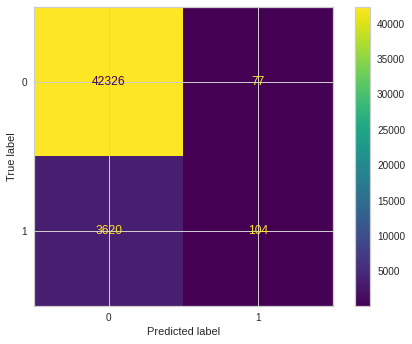

In [ ]:
#Print confusion matrix
cm_accuracy = confusion_matrix(y_test_feature_selected, predict_test_best_model_feature_selected["Label"])  
disp = ConfusionMatrixDisplay(confusion_matrix=cm_accuracy)
disp.plot()

## 4.3 Confusion matrix for tuned lightgbm model

In [ ]:
#Load the saved model
best_model_auc = load_model('/content/drive/MyDrive/AI_ML_Project/Data/best_model_auc')

Transformation Pipeline and Model Successfully Loaded


In [ ]:
#Predict on test data
predict_test_auc = predict_model(best_model_auc)
print(predict_test_auc)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9201,0.7672,0.043,0.5714,0.0799,0.0694,0.1408


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.9169
1                                         0  ...  0.9894
2                                         0  ...  0.9818
3                                         0  ...  0.8791
4                                         0  ...  0.9881
...                                     ...  ...     ...
46122                                     0  ...  0.9839
46123                                     0  ...  0.9912
46124                                     0  ...  0.6782
46125                                     0  ...  0.9731
46126                                     0  ...  0.9577

[46127 rows x 179 columns]


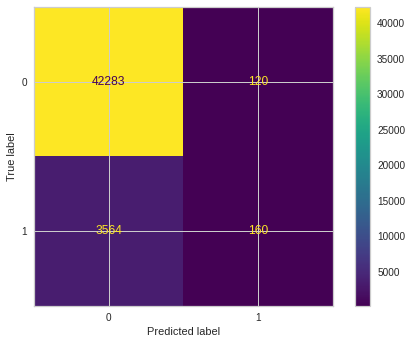

In [ ]:
#Print confusion matrix
cm_auc = confusion_matrix(y_test_feature_selected, predict_test_accuracy["Label"])  
disp = ConfusionMatrixDisplay(confusion_matrix=cm_auc)
disp.plot()

## 4.4 Observations

It is observed that the number of applicants who should not be given loan but are predicted as eligible for loan (i.e., the count of 3rd quadrant) is lower for tuned lightgbm. Hence, tuned lightgbm is the final selected model for further analysis. Here after this model will be named **best_model**.

# 5.0 Error Analysis

## 5.1 Train Lightgbm with tuned parameters

In [ ]:
#Data preparation
X_train_feature_selected_with_target = X_train_feature_selected
X_train_feature_selected_with_target["TARGET"] = y_train_feature_selected.to_numpy().flatten()
X_test_feature_selected_with_target = X_test_feature_selected
X_test_feature_selected_with_target["TARGET"] = y_test_feature_selected.to_numpy().flatten()

In [ ]:
#Rename columns to enable pycaret to read them
X_train_feature_selected_with_target = X_train_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_test_feature_selected_with_target = X_test_feature_selected_with_target.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
#Setup the dataset
data_feature_selected = setup(data=X_train_feature_selected_with_target, target="TARGET", test_data=X_test_feature_selected_with_target, preprocess=False, silent=True)

,Description,Value
0,session_id,2217
1,Target,TARGET
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(204494, 177)"
5,Missing Values,False
6,Numeric Features,176
7,Categorical Features,0
8,Transformed Train Set,"(204494, 176)"
9,Transformed Test Set,"(46127, 176)"


In [ ]:
best_model = create_model('lightgbm', bagging_fraction=0.7, bagging_freq=5,
                                 boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, feature_fraction=0.4,
                                 importance_type='split', learning_rate=0.05,
                                 max_depth=-1, min_child_samples=81,
                                 min_child_weight=0.001, min_split_gain=0.2,
                                 n_estimators=300, n_jobs=-1, num_leaves=200,
                                 objective=None, random_state=3067,
                                 reg_alpha=0.0005, reg_lambda=0.0005,
                                 silent='warn', subsample=1.0,
                                 subsample_for_bin=200000, subsample_freq=0)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9169,0.7662,0.0287,0.3902,0.0535,0.0427,0.0875
1,0.9187,0.7720,0.0454,0.5390,0.0838,0.0720,0.1390
2,0.9194,0.7662,0.0460,0.5923,0.0854,0.0745,0.1490
3,0.9181,0.7624,0.0335,0.4956,0.0627,0.0529,0.1125
4,0.9185,0.7657,0.0371,0.5254,0.0693,0.0591,0.1234
5,0.9182,0.7689,0.0329,0.5000,0.0617,0.0522,0.1123
6,0.9191,0.7643,0.0425,0.5680,0.0790,0.0684,0.1392
7,0.9174,0.7542,0.0275,0.4220,0.0517,0.0421,0.0909
8,0.9188,0.7589,0.0389,0.5508,0.0726,0.0625,0.1304
9,0.9186,0.7681,0.0383,0.5333,0.0714,0.0611,0.1266


In [ ]:
#Predict on test data
predict_test = predict_model(best_model)
print(predict_test)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9201,0.7672,0.043,0.5714,0.0799,0.0694,0.1408


       NAME_HOUSING_TYPE_Municipalapartment  ...   Score
0                                         0  ...  0.9169
1                                         0  ...  0.9894
2                                         0  ...  0.9818
3                                         0  ...  0.8791
4                                         0  ...  0.9881
...                                     ...  ...     ...
46122                                     0  ...  0.9839
46123                                     0  ...  0.9912
46124                                     0  ...  0.6782
46125                                     0  ...  0.9731
46126                                     0  ...  0.9577

[46127 rows x 179 columns]


In [ ]:
#Save the dataframes into CSV files for future use
predict_test.to_csv('predict_test.csv', index = False)

## 5.2 Model Interpretation

In [ ]:
#Prepare data frame of correctly predicted data points
X_test_correct_pred = predict_test[predict_test["TARGET"] == predict_test["Label"]]
y_test_correct_pred = X_test_correct_pred["TARGET"]
X_test_correct_pred = X_test_correct_pred.drop(columns=['TARGET', 'Label', 'Score'])
print("X_test_correct_pred", X_test_correct_pred.shape)

#Prepare data frame of wrongly predicted data points
X_test_wrong_pred = predict_test[predict_test["TARGET"] != predict_test["Label"]]
y_test_wrong_pred = X_test_wrong_pred["TARGET"]
X_test_wrong_pred = X_test_wrong_pred.drop(columns=['TARGET', 'Label', 'Score'])
print("X_test_wrong_pred", X_test_wrong_pred.shape)

X_test_correct_pred (42443, 176)
X_test_wrong_pred (3684, 176)


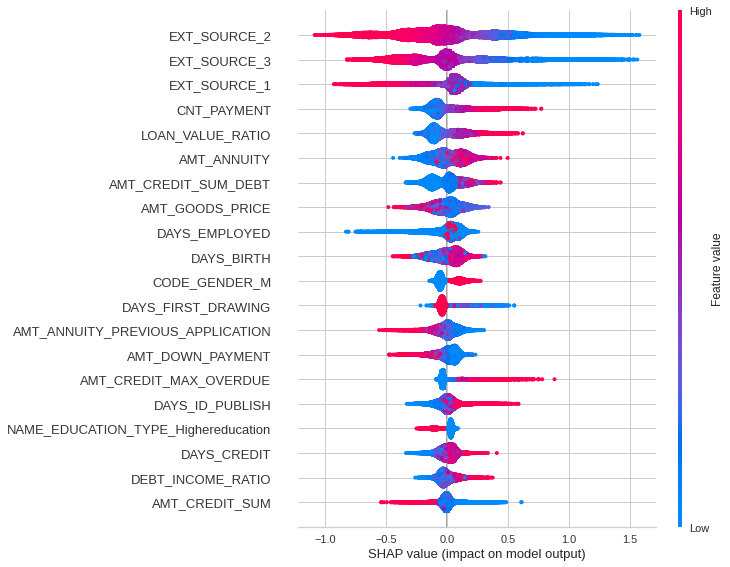

In [ ]:
#Interpret model using SHAP
interpret_model(best_model)

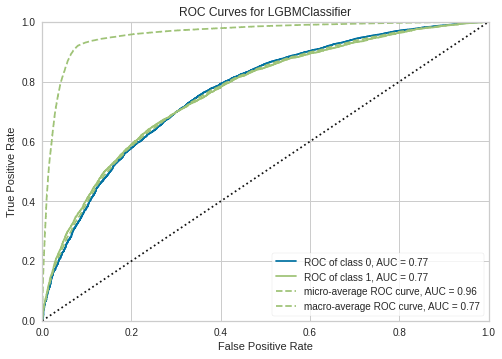

In [ ]:
#Plot AUC
plot_model(best_model, plot = 'auc')

In [ ]:
#Model interpretation using LIME for 10 data points which are wrongly predicted
x = []
for i in range(10):
  idx = i
  limeexplainer = LimeTabularExplainer(X_test_wrong_pred.values, feature_names = X_test_wrong_pred.columns, discretize_continuous = True)
  explainable_exp = limeexplainer.explain_instance(X_test_wrong_pred.values[idx], best_model.predict_proba, num_features=3)  
  explainable_exp.show_in_notebook(show_table=True, show_all=False)
  print("Actual TARGET value: ", y_test_wrong_pred.values[idx])
  x += explainable_exp.as_list()

y = [x[i][0].split()[0] if x[i][0].split()[0][1].isalpha() else x[i][0].split()[2] for i in range(len(x))]
unique, counts = np.unique(y, return_counts=True)
z = dict(zip(unique, counts))

Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


In [ ]:
#Find top 3 features for wrongly predicted data points
from operator import itemgetter
sort_dict_wrong= dict(sorted(z.items(), key=itemgetter(1), reverse=True)) 
m = list(sort_dict_wrong.keys())
top_features_wrong_pred = m[0:3]
print("Top 3 features for wrong predictions: ", top_features_wrong_pred)

Top 3 features for wrong predictions:  ['EXT_SOURCE_2', 'EXT_SOURCE_3', 'EXT_SOURCE_1']


In [ ]:
#Model interpretation using LIME for 10 data points which are correctly predicted
a = []
for i in range(10):
  idx = i
  limeexplainer = LimeTabularExplainer(X_test_correct_pred.values, feature_names = X_test_correct_pred.columns, discretize_continuous = True)
  explainable_exp = limeexplainer.explain_instance(X_test_correct_pred.values[idx], best_model.predict_proba, num_features=3)  
  explainable_exp.show_in_notebook(show_table=True, show_all=False)
  print("Actual TARGET value: ", y_test_wrong_pred.values[idx])
  a += explainable_exp.as_list()

b = [a[i][0].split()[0] if a[i][0].split()[0][1].isalpha() else a[i][0].split()[2] for i in range(len(a))]
unique, counts = np.unique(y, return_counts=True)
c = dict(zip(unique, counts))

Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


Actual TARGET value:  1


In [ ]:
#Find top 3 features for correctly predicted data points
from operator import itemgetter
sort_dict_correct= dict(sorted(c.items(), key=itemgetter(1), reverse=True)) 
n = list(sort_dict_correct.keys())
top_features_correct_pred = n[0:3]
print("Top 3 features for correct predictions: ", top_features_correct_pred)

Top 3 features for correct predictions:  ['EXT_SOURCE_2', 'EXT_SOURCE_3', 'EXT_SOURCE_1']


It is observed that EXT_SOUCE_2, EXT_SORCE_3 and EXT_SOURCE_1 are the top 3 features for both wrongly predicted and correctly predicted data points.



## 5.3 Plots based on model interpretation

{'boxes': [<matplotlib.lines.Line2D at 0x7f991f366710>,
 'caps': [<matplotlib.lines.Line2D at 0x7f991f5cf0d0>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f991f5c6710>,
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x7f991f5c68d0>,
 'whiskers': [<matplotlib.lines.Line2D at 0x7f991f366290>,
  <matplotlib.lines.Line2D at 0x7f991f5bd6d0>]}

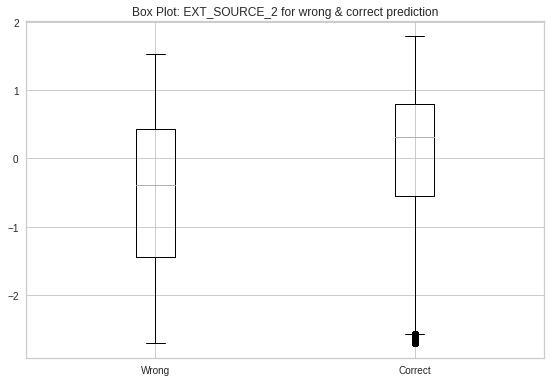

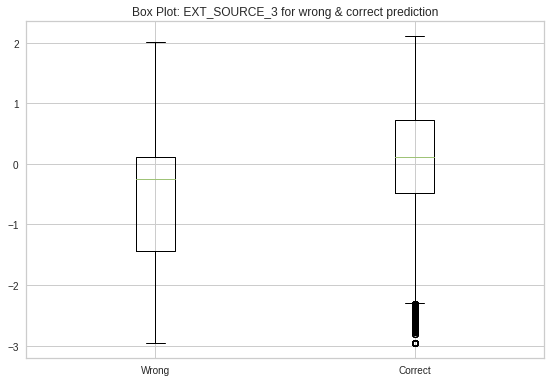

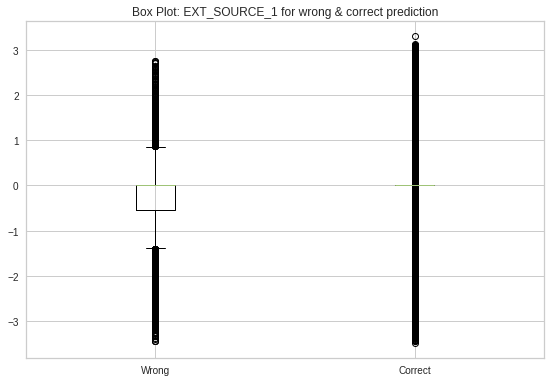

In [ ]:
#Box plot for EXT_SOURCE_2 for wrongly and correctly predicted data points
fig, ax = plt.subplots()
fig.subplots_adjust(left=0.08, right=0.98, bottom=0.05, top=0.9, hspace=0.4, wspace=0.3)
ax.set_title('Box Plot: EXT_SOURCE_2 for wrong & correct prediction')
xticklabels = ['Wrong', 'Correct']
ax.set_xticklabels(xticklabels)
ax.boxplot([X_test_wrong_pred['EXT_SOURCE_2'], X_test_correct_pred['EXT_SOURCE_2']])

#Box plot for EXT_SOURCE_3 for wrongly and correctly predicted data points
fig, ax = plt.subplots()
fig.subplots_adjust(left=0.08, right=0.98, bottom=0.05, top=0.9, hspace=0.4, wspace=0.3)
ax.set_title('Box Plot: EXT_SOURCE_3 for wrong & correct prediction')
xticklabels = ['Wrong', 'Correct']
ax.set_xticklabels(xticklabels)
ax.boxplot([X_test_wrong_pred['EXT_SOURCE_3'], X_test_correct_pred['EXT_SOURCE_3']])

#Box plot for EXT_SOURCE_1 for wrongly and correctly predicted data points
fig, ax = plt.subplots()
fig.subplots_adjust(left=0.08, right=0.98, bottom=0.05, top=0.9, hspace=0.4, wspace=0.3)
ax.set_title('Box Plot: EXT_SOURCE_1 for wrong & correct prediction')
xticklabels = ['Wrong', 'Correct']
ax.set_xticklabels(xticklabels)
ax.boxplot([X_test_wrong_pred['EXT_SOURCE_1'], X_test_correct_pred['EXT_SOURCE_1']])

(array([  289.,  1239.,  1991.,  2388.,  2611., 26450.,  2678.,  2536.,
         1817.,   444.]),
 array([-3.477 , -2.8   , -2.123 , -1.446 , -0.7695, -0.0928,  0.584 ,
         1.261 ,  1.9375,  2.613 ,  3.291 ], dtype=float16),
 <a list of 10 Patch objects>)

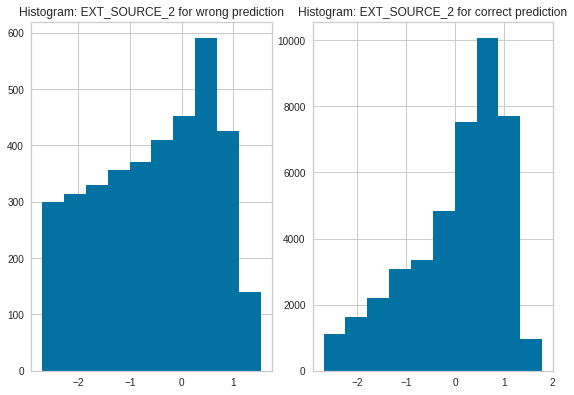

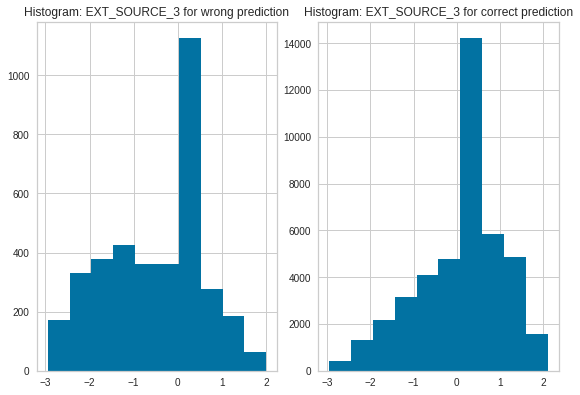

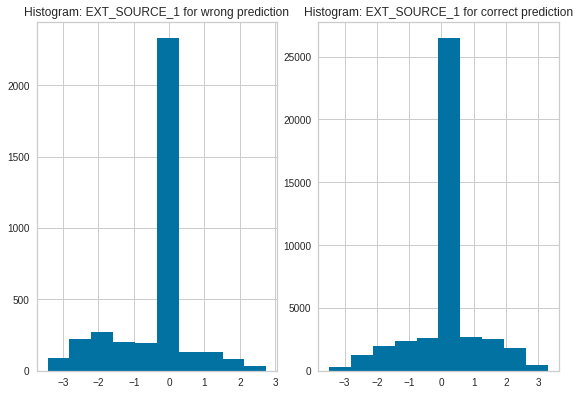

In [ ]:
#Histogram for EXT_SOURCE_2 for wrongly and correctly predicted data points
fig, (ax1, ax2) = plt.subplots(1,2)
plt.tight_layout()
ax1.set_title('Histogram: EXT_SOURCE_2 for wrong prediction')
ax1.hist(X_test_wrong_pred['EXT_SOURCE_2'])
ax2.set_title('Histogram: EXT_SOURCE_2 for correct prediction')
ax2.hist(X_test_correct_pred['EXT_SOURCE_2'])

#Histogram for EXT_SOURCE_3 for wrongly and correctly predicted data points
fig, (ax1, ax2) = plt.subplots(1,2)
plt.tight_layout()
ax1.set_title('Histogram: EXT_SOURCE_3 for wrong prediction')
ax1.hist(X_test_wrong_pred['EXT_SOURCE_3'])
ax2.set_title('Histogram: EXT_SOURCE_3 for correct prediction')
ax2.hist(X_test_correct_pred['EXT_SOURCE_3'])

#Histogram for EXT_SOURCE_1 for wrongly and correctly predicted data points
fig, (ax1, ax2) = plt.subplots(1,2)
plt.tight_layout()
ax1.set_title('Histogram: EXT_SOURCE_1 for wrong prediction')
ax1.hist(X_test_wrong_pred['EXT_SOURCE_1'])
ax2.set_title('Histogram: EXT_SOURCE_1 for correct prediction')
ax2.hist(X_test_correct_pred['EXT_SOURCE_1'])

## 5.4 Observations

* Top 3 features influencing wrongly and correctly predicted points are the same. They are EXT_SOUCE_2, EXT_SORCE_3 and EXT_SOURCE_1.
* Spread of data points for these 3 features for wrongly predicted data points is lower than correctly predicted data points.
* Statistically data is found in the same scale (Standard scaling was performed on data during phase 2) as observed in the box plot. 
* From the histograms, it is observed that outliers are more pronounced for correctly predicted data points.
* It can be concluded that features are not having an impact on prediction as top 3 features for wrongly and correctly predicted data points are the same.
* Plots for the top features don't give any conclusive interpretation for predictions.
* It calls for introduction of more features through advanced feature engineering. Advanced feature engineering will be performed in the next section.
